In [1]:
import os
import torch
import torch.nn as nn
import torch.utils.data
import torch.optim as optim
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

C:\Users\canof\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
dataroot = "../sprites"
workers = 2
batch_size = 64 # originally 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 96 

# Number of channels in the training images. For color images this is 3
nc = 16 # will creating a 16 element "palette" and condensing to RGB that way
imc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 16 # originally 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 500

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

total_epochs = 0

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

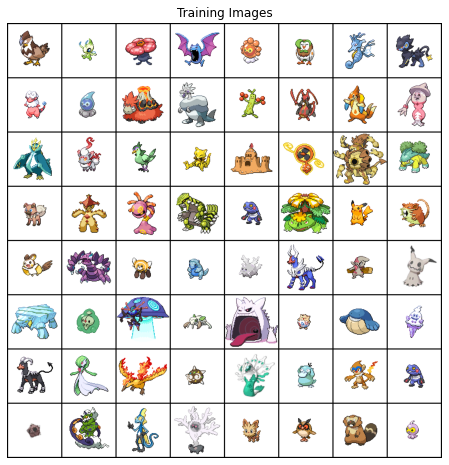

In [3]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
# initialize weights
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


In [5]:
# Code for 3 x 96 x 96 generator
# TO EXPLORE: Add random noise to each layer
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            # Major change between tutorial happens here as I need to end up with a 3x96x96 image
            nn.ConvTranspose2d( nz, ngf * 8, 6, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            # Original model used an inplace ReLU, ganhacks suggests using leakyReLU in both G and D
            nn.LeakyReLU(0.2, inplace=True), 
            # state size: (ngf*8) x 6 x 6
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ngf*4) x 12 x 12
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ngf*2) x 24 x 24
            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ngf) x 48 x 48
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Softmax(dim=1)
            # state size: (nc) x 96 x 96
        )

        self.colorspace_r = self.build_colorspace(input_dim=nz, output_dim=nc)
        self.colorspace_g = self.build_colorspace(input_dim=nz, output_dim=nc)
        self.colorspace_b = self.build_colorspace(input_dim=nz, output_dim=nc)

        self.color_upsampler = nn.Upsample(scale_factor=image_size)
            
    def build_colorspace(self, input_dim: int, output_dim: int):
        '''Simple NN method to generate a color palette to be used by each color channel'''
        colorspace = nn.Sequential(
            nn.Linear(input_dim, 128, bias=True),
            nn.BatchNorm1d(128),
            nn.LeakyReLU(0.2, inplace=True),
            # state: 128 element vector
            nn.Linear(128, 64, bias=True),
            nn.BatchNorm1d(64),
            nn.LeakyReLU(0.2, inplace=True),
            # state: 64 element vector
            nn.Linear(64, output_dim, bias=True),
            nn.Tanh(),
        )
        return colorspace

    def forward(self, input):
        intermediate_image = self.main(input)

        # TODO: Explore condensing this stupid block into a series of multiplications a la:
        # in: b x 16 x 96 x 96 -> transpose_(1, 3) -> b x 96 x 96 x 16 @ 16 x 3 -> transpose_(1, 3) -> b x 3 x 96 x 96
        # There's a wrinkle, batches make this more difficult I think, need to explore more (views, etc. etc.)

        r_space = self.colorspace_r(input.view(-1, nc))
        r_space = r_space.view((-1, nc, 1, 1))
        r_space = self.color_upsampler(r_space)
        r_space = intermediate_image * r_space
        r_space = torch.sum(r_space, dim=1, keepdim=True)

        g_space = self.colorspace_g(input.view(-1, nc))
        g_space = g_space.view((-1, nc, 1, 1))
        g_space = self.color_upsampler(g_space)
        g_space = intermediate_image * g_space
        g_space = torch.sum(g_space, dim=1, keepdim=True)

        b_space = self.colorspace_b(input.view(-1, nc))
        b_space = b_space.view((-1, nc, 1, 1))
        b_space = self.color_upsampler(b_space)
        b_space = intermediate_image * b_space
        b_space = torch.sum(b_space, dim=1, keepdim=True)

        output_image = torch.cat((r_space, g_space, b_space), dim=1)

        return output_image
       

In [6]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

netG.apply(weights_init)

print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(16, 512, kernel_size=(6, 6), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.2, inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.2, inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.2, inplace=True)
    (12): ConvTransp

In [7]:
class ConvBlock(nn.Module):
    
    def __init__(self, input_dim, output_dim, kernel=4, stride=2, padding=1):    
        super(ConvBlock, self).__init__()
        self.main = nn.Sequential(
            nn.Conv2d(input_dim, output_dim, kernel, stride, padding, bias=False),
            nn.BatchNorm2d(output_dim),
            nn.LeakyReLU(0.2)
        )

    def forward(self, input):
        return self.main(input)


class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input: (nc) x 96 x 96
            nn.Conv2d(imc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf) x 48 x 48
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf * 2) x 24 x 24
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf * 4) x 12 x 12
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size: (ndf * 8) x 6 x 6
            nn.Conv2d(ndf * 8, 1, 6, 1, 0, bias=False),
            nn.Sigmoid()
        )
    
    def forward(self, input):
        return self.main(input)

In [8]:
# create the discriminator

netD = Discriminator(ngpu).to(device)

# Parallelization
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

netD.apply(weights_init)

print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(6, 6), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [11]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

AttributeError: '_IncompatibleKeys' object has no attribute 'parameters'

In [ ]:
# Read in checkpointed model if it exists
GEN_PATH = "cs_generator.tar"
DISCRIM_PATH = "cs_discriminator.tar"

if os.path.exists(GEN_PATH):
    checkpoint = torch.load(GEN_PATH)
    netG.load_state_dict(checkpoint["model_state_dict"])
    optimizerG.load_state_dict(checkpoint["optimizer_state_dict"])
    total_epochs = checkpoint["epoch"]
    errG = checkpoint["loss"]

if os.path.exists(DISCRIM_PATH):
    checkpoint = torch.load(DISCRIM_PATH)
    netD.load_state_dict(checkpoint["model_state_dict"])
    optimizerD.load_state_dict(checkpoint["optimizer_state_dict"])
    total_epochs = checkpoint["epoch"]
    errD = checkpoint["loss"]

In [12]:
# Training loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        # label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        label = torch.rand((b_size,), device=device) * .5 + .7
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        # label.fill_(fake_label)
        label = torch.rand((b_size,), device=device) * 0.3
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        # label.fill_(real_label)  # fake labels are real for generator cost
        label = torch.rand((b_size,), device=device) * .5 + .7
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 15 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...


AttributeError: '_IncompatibleKeys' object has no attribute 'zero_grad'

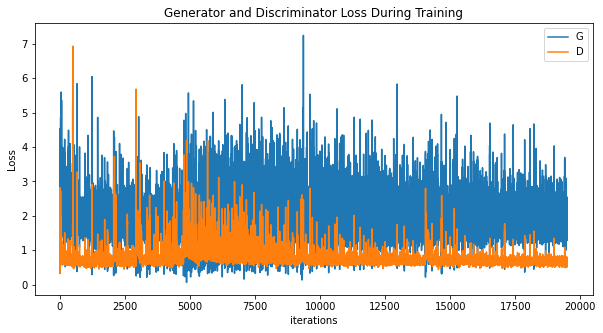

In [12]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21290413 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


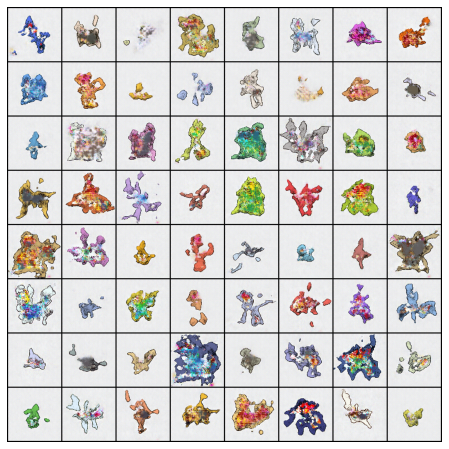

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [14]:
ani.save('colorchannel_gan.mp4', fps=3, extra_args=['-vcodec', 'libx264'])

In [15]:
# save generator
GEN_PATH = "cs_generator.tar"
if os.path.exists(GEN_PATH): gen_path = "cs_generator_new.pt"

torch.save({
            'epoch': total_epochs + epoch + 1,
            'model_state_dict': netG.state_dict(),
            'optimizer_state_dict': optimizerG.state_dict(),
            'loss': errG,
            }, GEN_PATH)

# save discriminator

DISCRIM_PATH = "cs_disriminator.tar"
torch.save({
            'epoch': total_epochs + epoch + 1,
            'model_state_dict': netD.state_dict(),
            'optimizer_state_dict': optimizerD.state_dict(),
            'loss': errD,
            }, DISCRIM_PATH)
